In [1]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.optimizers import Adam

import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt

In [2]:
path = 'c:/Users/admin/Documents/Datasets/ETHEC_dataset_butterfly/IMAGO_build_test_resized/'

train_images = tf.keras.utils.image_dataset_from_directory(path, image_size=(64, 64), batch_size=512)

Found 46347 files belonging to 99 classes.


In [3]:
train_images

<BatchDataset element_spec=(TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [4]:
for x, y in train_images.take(1):
    print(x.shape)

(512, 64, 64, 3)


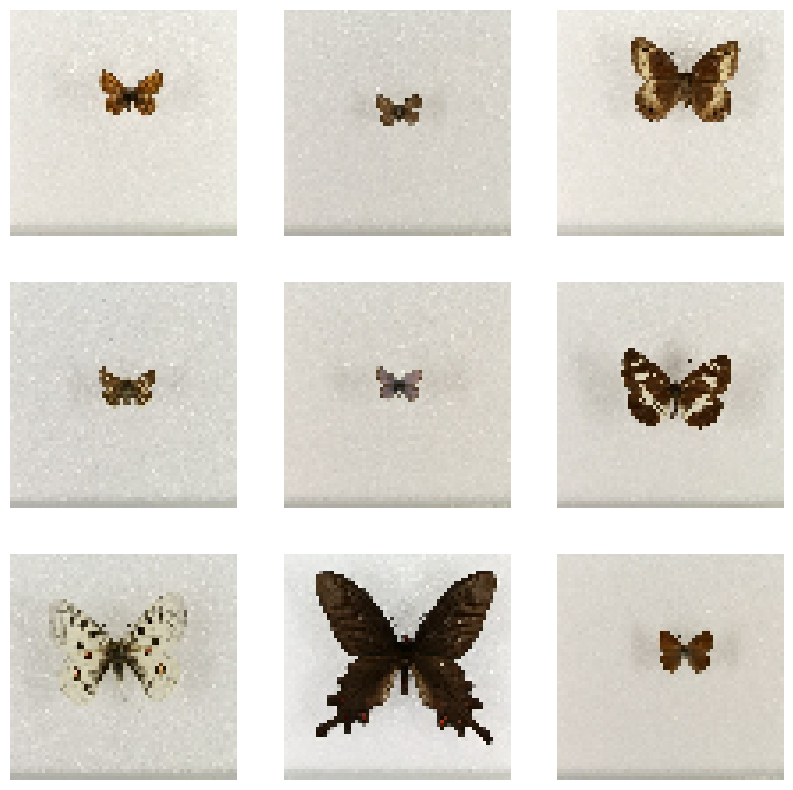

In [5]:
plt.figure(figsize=(10, 10))
for images, labels in train_images.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.axis("off")

In [6]:
normalization_layer = layers.Rescaling(1./255)
normalized_train_images = train_images.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_train_images))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 0.95294124


In [7]:
image_shape = (64, 64, 3)
batch_size = 512

In [8]:
class WGAN_GP():
    def __init__(self, input_shape):

        self.z_dim = 128
        self.input_shape = input_shape

        self.loss_critic = {}
        self.loss_gp = {}
        self.loss_generator = {}
        
        # critic
        self.n_critic = 5
        self.penalty_const = 10
        self.critic = self.build_critic()
        self.critic.trainable = False

        self.optimizer_critic = Adam(1e-4, 0.5, 0.9)

        # build generator pipeline with frozen critic
        self.generator = self.build_generator()
        critic_output = self.critic(self.generator.output)
        self.model = Model(self.generator.input, critic_output)
        self.model.compile(loss = self.wasserstein_loss,
                           optimizer = Adam(1e-4, 0.5, 0.9))
        self.critic.trainable = True
        
    def wasserstein_loss(self, y_true, y_pred):

        w_loss = -tf.reduce_mean(y_true*y_pred)

        return w_loss

    def build_generator(self):

        DIM = 128
        model = tf.keras.Sequential(name='Generator') 

        model.add(layers.Input(shape=[self.z_dim])) 

        model.add(layers.Dense(4*4*8*DIM))
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        model.add(layers.Reshape((4,4,8*DIM))) 

        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))
        model.add(layers.Conv2D(4*DIM, 5, padding='same')) 
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))
        model.add(layers.Conv2D(2*DIM, 5, padding='same')) 
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())

        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))
        model.add(layers.Conv2D(DIM, 5, padding='same')) 
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())

        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))       
        model.add(layers.Conv2D(image_shape[-1], 5, padding='same', activation='tanh')) 

        return model             
    
    def build_critic(self):

        DIM = 128
        model = tf.keras.Sequential(name='critics') 

        model.add(layers.Input(shape=self.input_shape)) 

        model.add(layers.Conv2D(1*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(2*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(4*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(8*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Flatten()) 
        model.add(layers.Dense(1)) 

        return model     
    
 
    def gradient_loss(self, grad):

        loss = tf.square(grad)
        loss = tf.reduce_sum(loss, axis=np.arange(1,len(loss.shape)))
        loss = tf.sqrt(loss)
        loss = tf.reduce_mean(tf.square(loss - 1))
        loss = self.penalty_const * loss
        return loss

    def train_critic(self, real_images, batch_size):
        real_labels = tf.ones(batch_size)
        fake_labels = -tf.ones(batch_size)
                  
        g_input = tf.random.normal((batch_size, self.z_dim))
        fake_images = self.generator.predict(g_input, verbose=0)
        
        with tf.GradientTape() as gradient_tape,\
             tf.GradientTape() as total_tape:
            
            # forward pass
            pred_fake = self.critic(fake_images)
            pred_real = self.critic(real_images)
            
            # calculate losses
            loss_fake = self.wasserstein_loss(fake_labels, pred_fake)
            loss_real = self.wasserstein_loss(real_labels, pred_real)           
            
            # gradient penalty      
            epsilon = tf.random.uniform((batch_size,1,1,1))
            interpolates = epsilon*real_images + (1-epsilon)*fake_images
            gradient_tape.watch(interpolates)
            
            critic_interpolates = self.critic(interpolates)
            gradients_interpolates = gradient_tape.gradient(critic_interpolates, [interpolates])
            gradient_penalty = self.gradient_loss(gradients_interpolates)
     
            # total loss
            total_loss = loss_fake + loss_real + gradient_penalty
            
            # apply gradients
            gradients = total_tape.gradient(total_loss, self.critic.trainable_variables)
            
            self.optimizer_critic.apply_gradients(zip(gradients, self.critic.trainable_variables))

        return loss_fake, loss_real, gradient_penalty
                                                
    def train(self, data_generator, batch_size, steps, interval=100):

        val_g_input = tf.random.normal((batch_size, self.z_dim))
        real_labels = tf.ones(batch_size)

        for i in range(steps):
            for _ in range(self.n_critic):
                real_images = data_generator
                loss_fake, loss_real, gradient_penalty = self.train_critic(real_images, batch_size)
                critic_loss = loss_fake + loss_real
            # train generator
            g_input = tf.random.normal((batch_size, self.z_dim))
            g_loss = self.model.train_on_batch(g_input, real_labels)
            self.loss_gp[i] = gradient_penalty
            self.loss_critic[i] = critic_loss.numpy()
            self.loss_generator[i] = g_loss
            if i%interval == 0:
                msg = "Step {}: g_loss {:.4f} critic_loss {:.4f} critic fake {:.4f}  critic_real {:.4f} penalty {:.4f}"\
                .format(i, g_loss, critic_loss, loss_fake, loss_real, gradient_penalty)
                print(msg)

                fake_images = self.generator.predict(val_g_input, verbose=0)
                self.plot_images(fake_images)
                # self.plot_losses()

    def plot_images(self, images):   
        grid_row = 1
        grid_col = 6
        f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*3.5, grid_row*3.5))
        for row in range(grid_row):
            for col in range(grid_col):
                if self.input_shape[-1]==1:
                    axarr[col].imshow(images[col,:,:,0]*0.5+0.5, cmap='gray')
                else:
                    axarr[col].imshow(images[col]*0.5+0.5)
                axarr[col].axis('off') 
        plt.show()

    def plot_losses(self):
        fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True)
        fig.set_figwidth(10)
        fig.set_figheight(6)
        ax1.plot(list(self.loss_critic.values()), label='Critic loss', alpha=0.7)
        ax1.set_title("Critic loss")
        ax2.plot(list(self.loss_generator.values()), label='Generator loss', alpha=0.7)
        ax2.set_title("Generator loss")
        ax3.plot(list(self.loss_gp.values()), label='Gradient penalty', alpha=0.7)
        ax3.set_title("Gradient penalty")
        plt.xlabel('Steps')
        plt.show()

In [9]:
wgan = WGAN_GP(image_shape)

Step 0: g_loss 2.5052 critic_loss -4.2279 critic fake -1.8147  critic_real -2.4132 penalty 0.3146


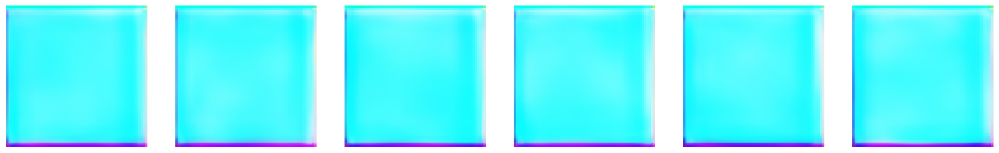

Step 100: g_loss -1.0633 critic_loss -0.7068 critic fake 0.8508  critic_real -1.5576 penalty 0.0595


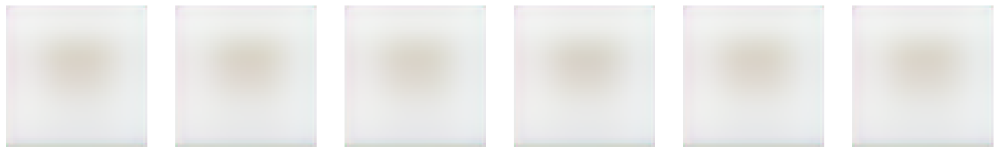

Step 200: g_loss 0.0354 critic_loss -0.3571 critic fake -0.1598  critic_real -0.1973 penalty 0.0332


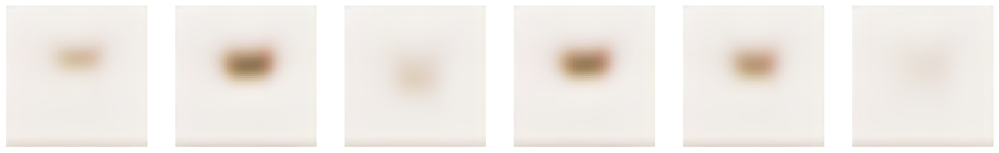

Step 300: g_loss 0.5544 critic_loss -0.2718 critic fake -0.5484  critic_real 0.2766 penalty 0.0176


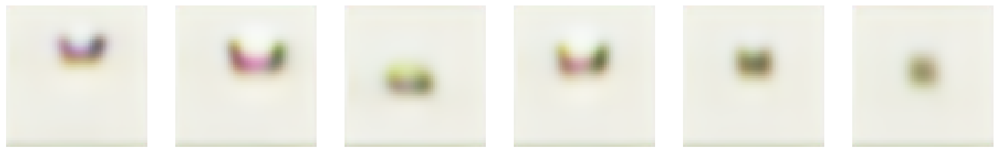

Step 400: g_loss 0.1876 critic_loss -0.2247 critic fake -0.2390  critic_real 0.0144 penalty 0.0081


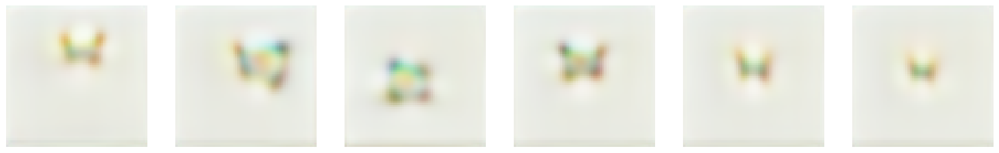

Step 500: g_loss 0.1887 critic_loss -0.2153 critic fake -0.1413  critic_real -0.0740 penalty 0.1479


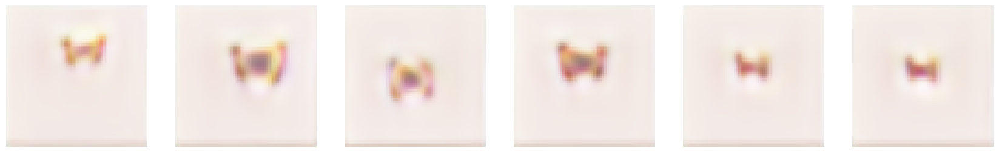

Step 600: g_loss 0.2804 critic_loss -0.2485 critic fake -0.4635  critic_real 0.2150 penalty 0.0741


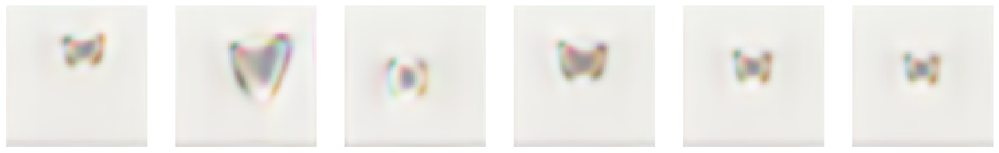

Step 700: g_loss -0.0400 critic_loss -0.2431 critic fake -0.0012  critic_real -0.2419 penalty 0.0000


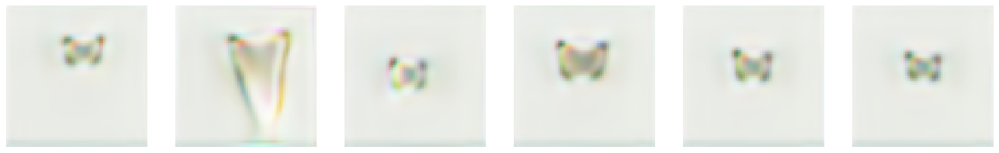

Step 800: g_loss 0.0916 critic_loss -0.2573 critic fake -0.0533  critic_real -0.2040 penalty 0.0006


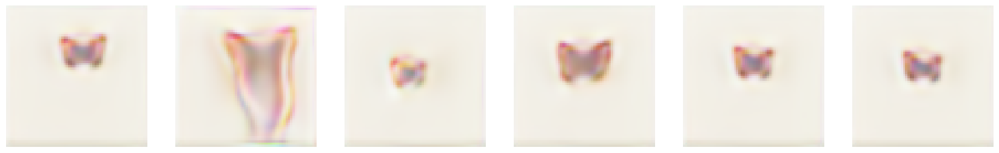

Step 900: g_loss 0.3439 critic_loss -0.2484 critic fake -0.2417  critic_real -0.0067 penalty 0.0081


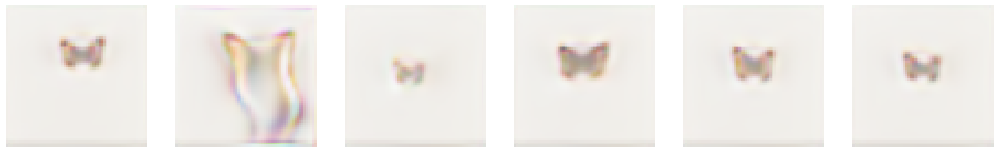

Step 1000: g_loss -0.1198 critic_loss -0.2241 critic fake 0.1366  critic_real -0.3606 penalty 0.1016


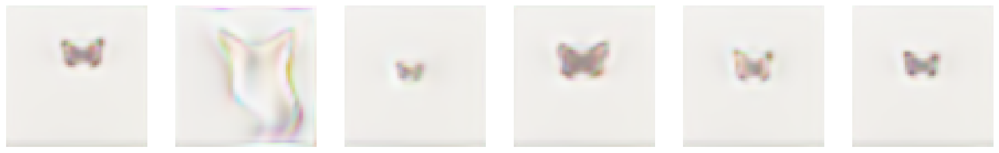

Step 1100: g_loss 0.4119 critic_loss -0.2587 critic fake -0.3755  critic_real 0.1168 penalty 0.0099


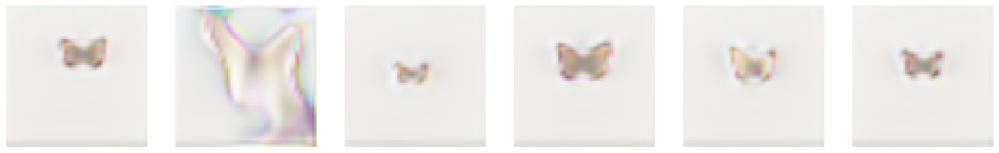

Step 1200: g_loss -0.0255 critic_loss -0.2425 critic fake 0.0308  critic_real -0.2733 penalty 0.0016


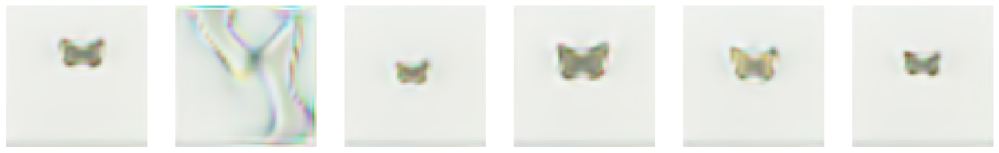

Step 1300: g_loss -0.0526 critic_loss -0.2503 critic fake 0.0484  critic_real -0.2987 penalty 0.0000


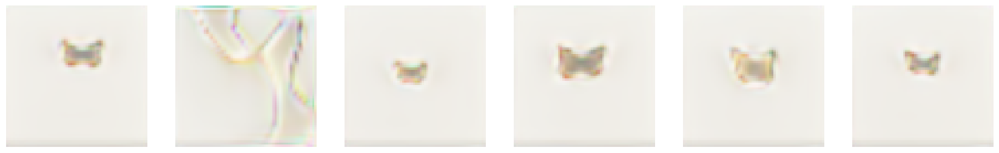

Step 1400: g_loss 0.0633 critic_loss -0.2668 critic fake -0.0707  critic_real -0.1962 penalty 0.0102


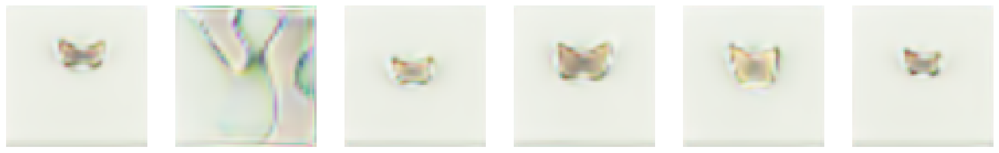

Step 1500: g_loss -0.0342 critic_loss -0.2620 critic fake 0.0490  critic_real -0.3110 penalty 0.0008


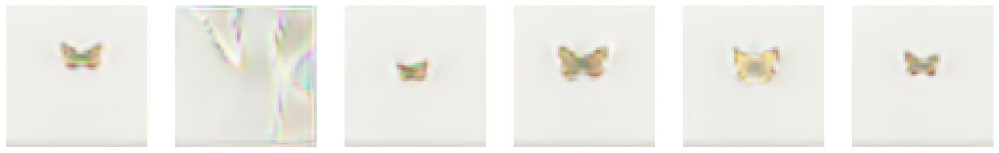

Step 1600: g_loss 0.0956 critic_loss -0.2502 critic fake -0.0605  critic_real -0.1897 penalty 0.0008


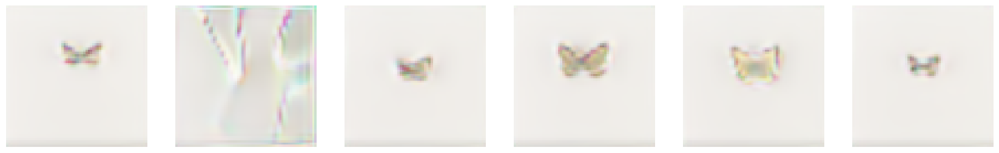

Step 1700: g_loss 0.0156 critic_loss -0.2670 critic fake -0.0184  critic_real -0.2485 penalty 0.0094


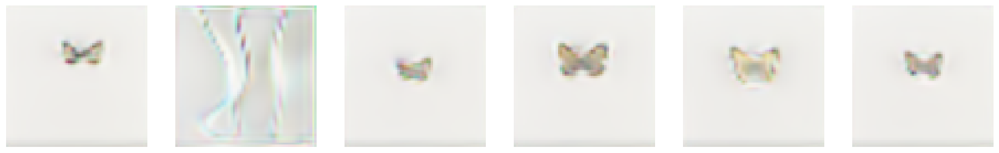

Step 1800: g_loss 0.0359 critic_loss -0.2820 critic fake -0.0571  critic_real -0.2249 penalty 0.0311


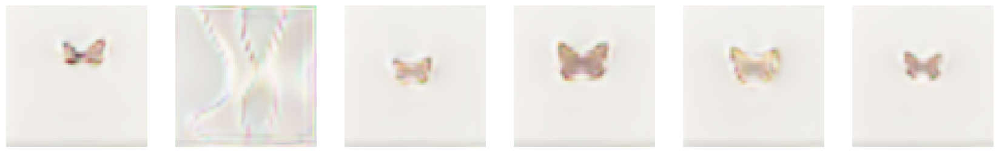

Step 1900: g_loss 0.0019 critic_loss -0.2783 critic fake -0.0118  critic_real -0.2665 penalty 0.0205


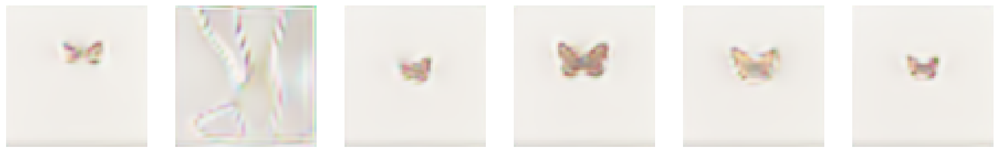

Step 2000: g_loss 0.0216 critic_loss -0.2730 critic fake 0.0216  critic_real -0.2946 penalty 0.0001


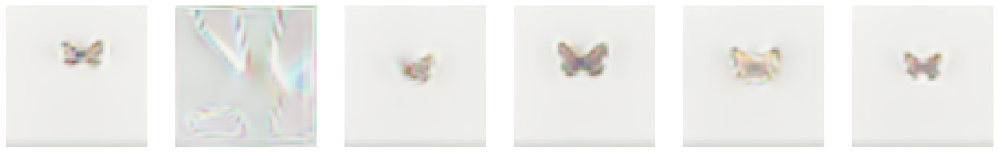

Step 2100: g_loss 0.0549 critic_loss -0.2752 critic fake -0.0268  critic_real -0.2483 penalty 0.0069


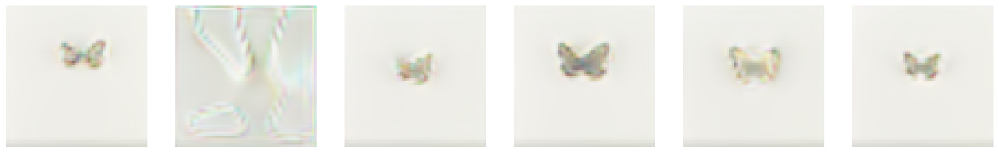

Step 2200: g_loss 0.0339 critic_loss -0.2665 critic fake -0.0523  critic_real -0.2142 penalty 0.0089


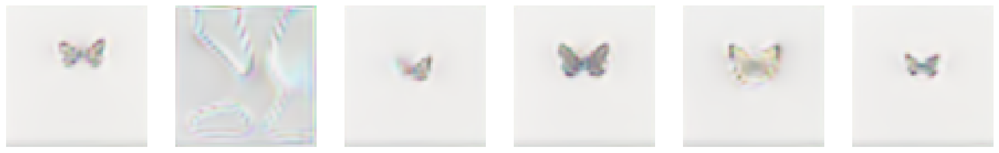

KeyboardInterrupt: 

In [10]:
wgan.train(image_batch, 512, 50000, 100)

In [ ]:
# wgan.model.summary()

In [ ]:
# wgan.generator.summary()

In [ ]:
# wgan.critic.summary()

1/1 [==============================] - 0s 469ms/step


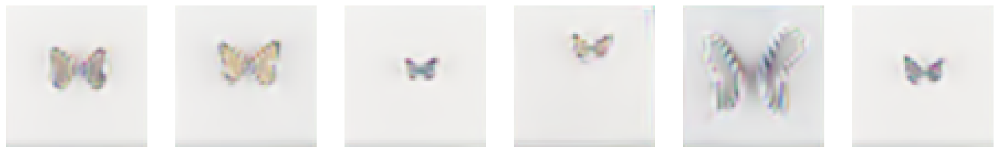

In [11]:
z = tf.random.normal((8, 128))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

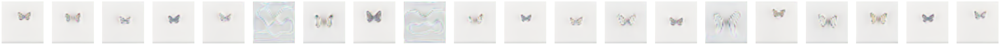

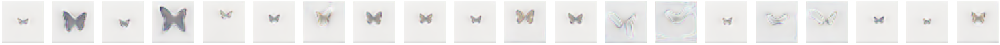

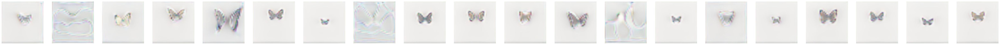

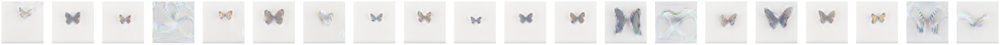

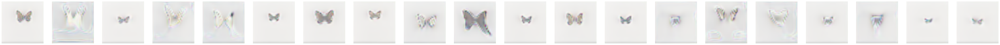

...

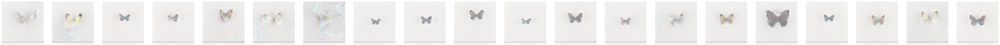

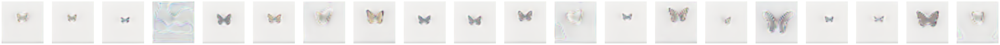

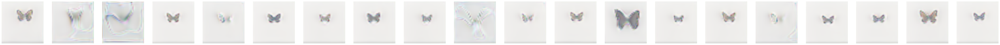

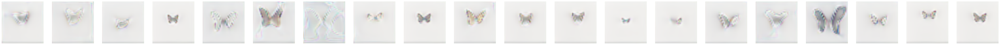

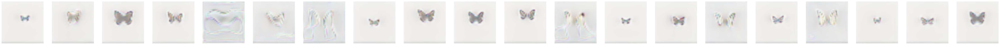

In [12]:
for i in range(20):
    z = tf.random.normal((20, 128))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

In [13]:
wgan.generator.save_weights('wgan_gp_butterfly_2200.weights')

In [14]:
wgan.generator.save('wgan_gp_butterfly_model_2200')

INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_2200\assets


INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_2200\assets


Step 0: g_loss -0.0227 critic_loss -0.2907 critic fake 0.0007  critic_real -0.2914 penalty 0.0014


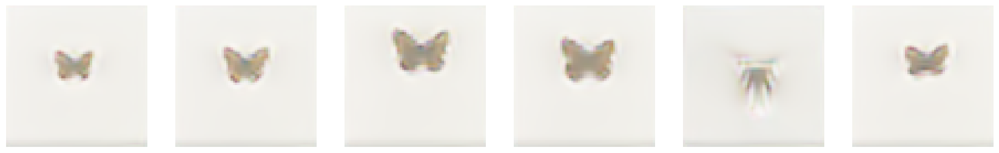

Step 100: g_loss -0.0296 critic_loss -0.3006 critic fake 0.0325  critic_real -0.3331 penalty 0.0090


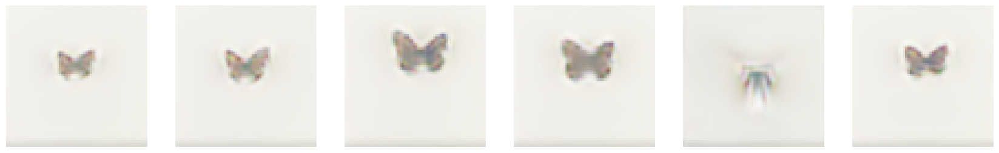

Step 200: g_loss 0.0549 critic_loss -0.2841 critic fake -0.0490  critic_real -0.2351 penalty 0.0000


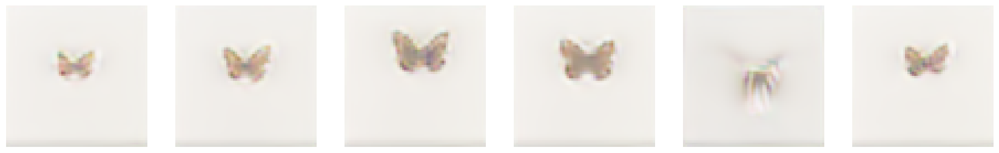

Step 300: g_loss 0.0540 critic_loss -0.2766 critic fake -0.0312  critic_real -0.2454 penalty 0.0045


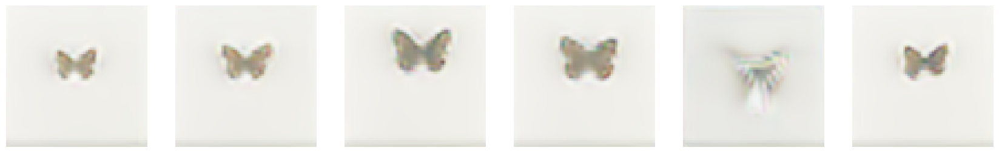

Step 400: g_loss 0.0205 critic_loss -0.2989 critic fake -0.0003  critic_real -0.2986 penalty 0.0184


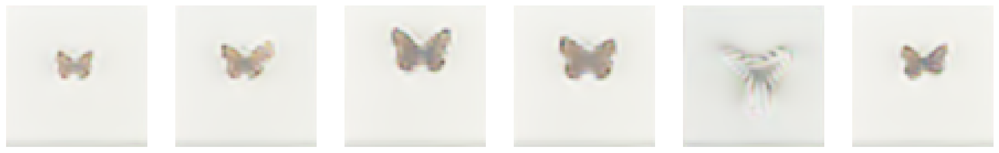

Step 500: g_loss -0.0017 critic_loss -0.2971 critic fake -0.0135  critic_real -0.2836 penalty 0.0030


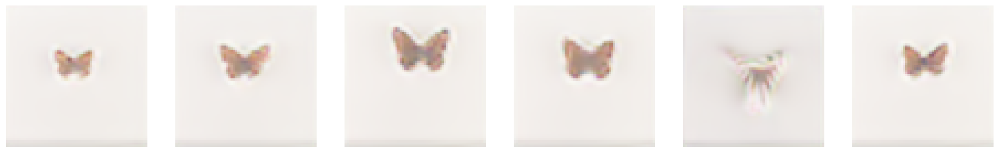

Step 600: g_loss 0.0025 critic_loss -0.3021 critic fake -0.0026  critic_real -0.2995 penalty 0.0046


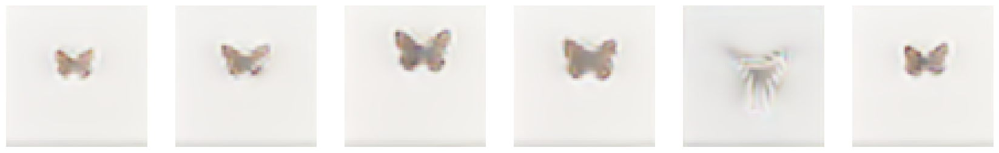

Step 700: g_loss -0.0069 critic_loss -0.3043 critic fake 0.0216  critic_real -0.3259 penalty 0.0003


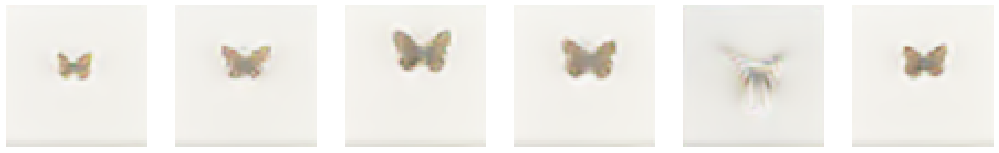

Step 800: g_loss 0.0208 critic_loss -0.2995 critic fake -0.0064  critic_real -0.2930 penalty 0.0060


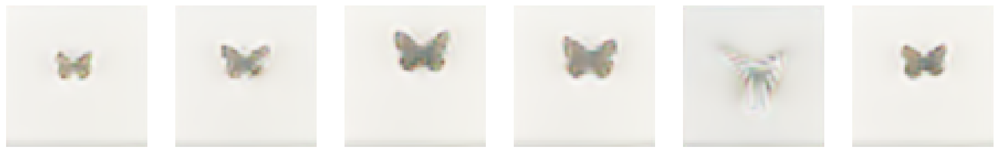

Step 900: g_loss 0.0327 critic_loss -0.3162 critic fake 0.0131  critic_real -0.3292 penalty 0.0047


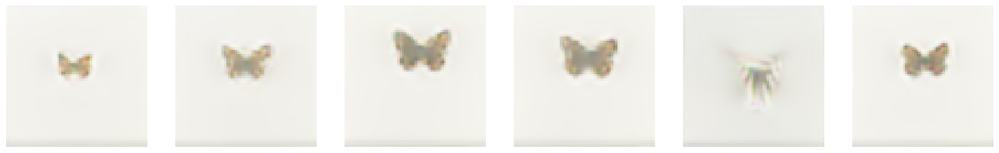

Step 1000: g_loss -0.0022 critic_loss -0.2971 critic fake -0.0104  critic_real -0.2867 penalty 0.0079


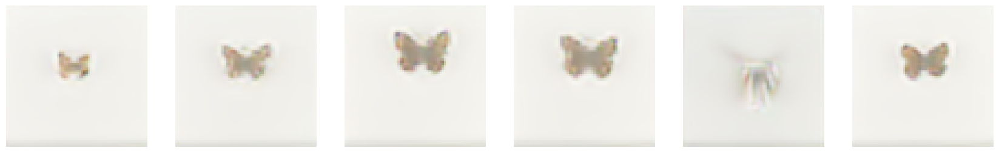

Step 1100: g_loss 0.0138 critic_loss -0.3250 critic fake 0.0079  critic_real -0.3328 penalty 0.0359


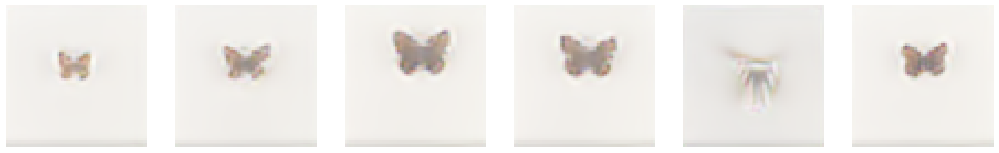

Step 1200: g_loss -0.0022 critic_loss -0.3009 critic fake -0.0026  critic_real -0.2983 penalty 0.0002


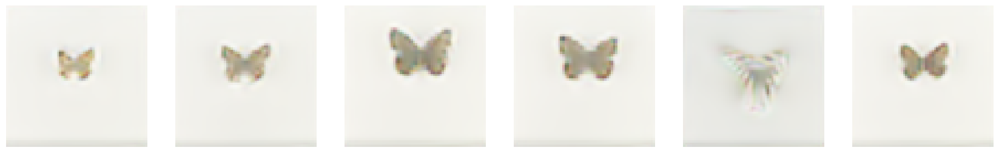

Step 1300: g_loss 0.0166 critic_loss -0.3047 critic fake -0.0283  critic_real -0.2764 penalty 0.0017


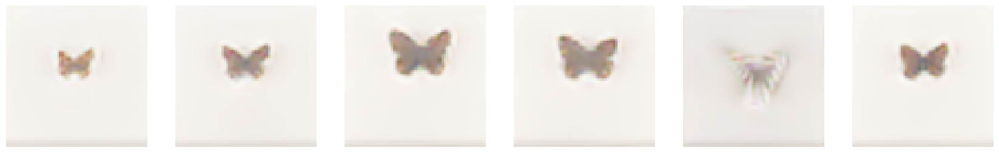

Step 1400: g_loss 0.0063 critic_loss -0.3116 critic fake 0.0177  critic_real -0.3293 penalty 0.0001


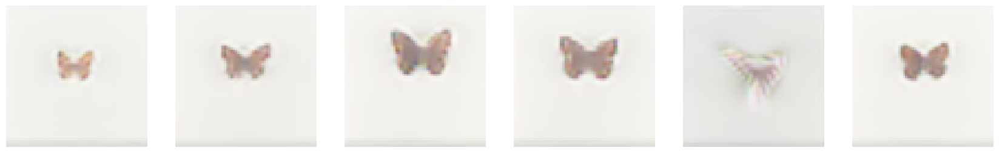

Step 1500: g_loss 0.0129 critic_loss -0.3226 critic fake 0.0005  critic_real -0.3231 penalty 0.0008


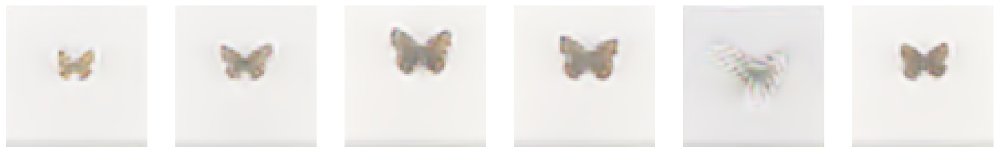

Step 1600: g_loss 0.0257 critic_loss -0.3111 critic fake 0.0004  critic_real -0.3115 penalty 0.0000


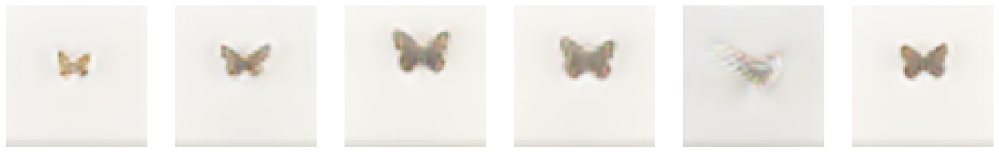

Step 1700: g_loss 0.0146 critic_loss -0.3225 critic fake -0.0134  critic_real -0.3091 penalty 0.0000


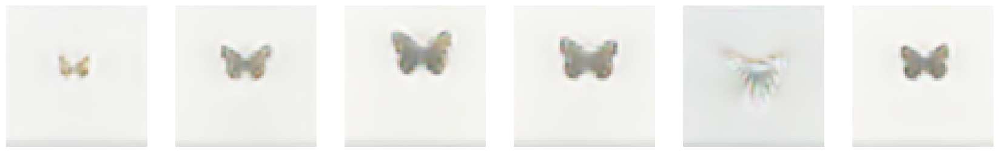

Step 1800: g_loss 0.0194 critic_loss -0.3231 critic fake -0.0265  critic_real -0.2965 penalty 0.0017


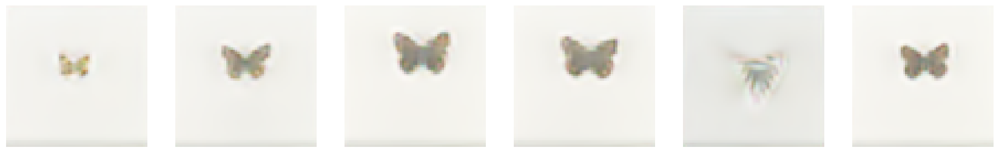

Step 1900: g_loss 0.0131 critic_loss -0.3033 critic fake -0.0338  critic_real -0.2694 penalty 0.0107


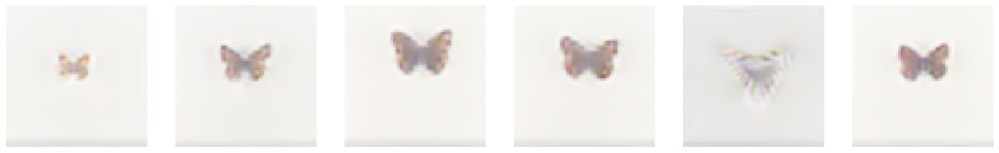

Step 2000: g_loss 0.0236 critic_loss -0.3289 critic fake 0.0092  critic_real -0.3381 penalty 0.0177


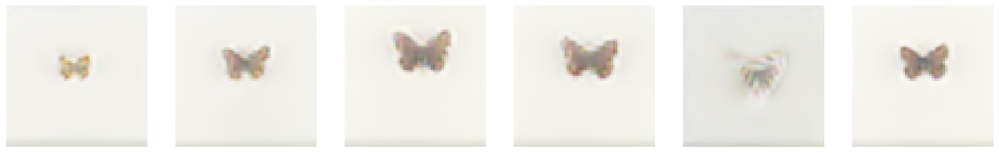

Step 2100: g_loss 0.0657 critic_loss -0.3272 critic fake -0.0605  critic_real -0.2667 penalty 0.0038


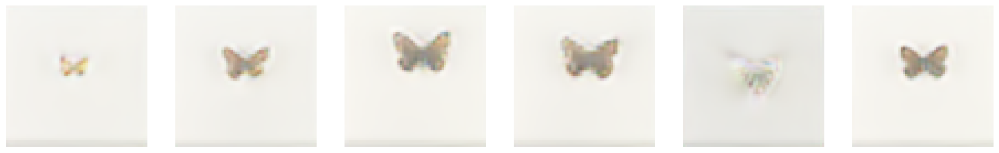

Step 2200: g_loss 0.0258 critic_loss -0.3310 critic fake -0.0037  critic_real -0.3273 penalty 0.0111


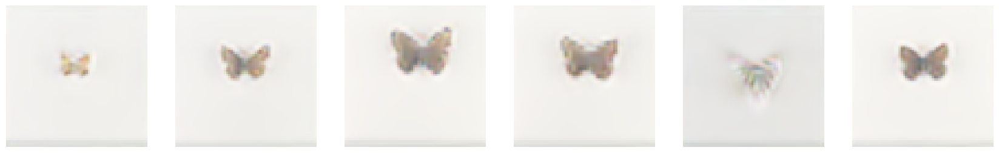

Step 2300: g_loss 0.0679 critic_loss -0.3254 critic fake -0.0426  critic_real -0.2828 penalty 0.0009


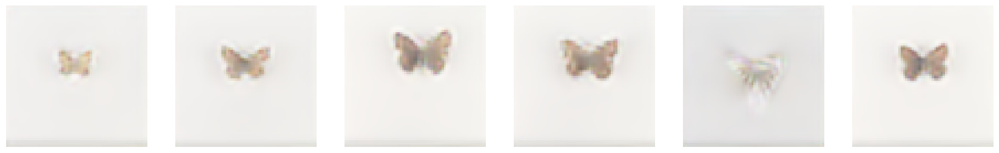

Step 2400: g_loss 0.0038 critic_loss -0.3376 critic fake 0.0061  critic_real -0.3437 penalty 0.0421


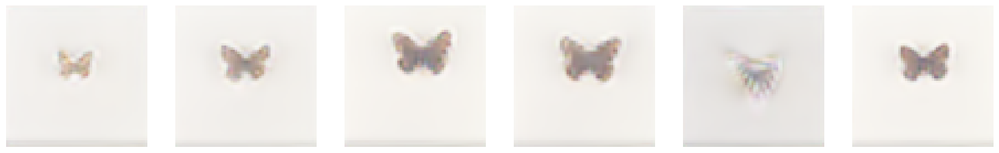

Step 2500: g_loss 0.1045 critic_loss -0.3350 critic fake -0.0767  critic_real -0.2584 penalty 0.0009


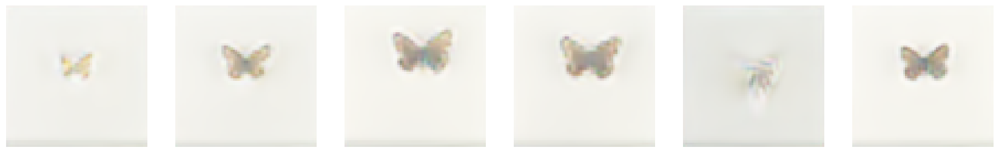

Step 2600: g_loss 0.0075 critic_loss -0.3288 critic fake 0.0099  critic_real -0.3386 penalty 0.0008


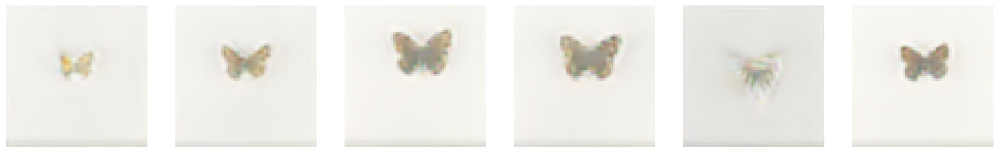

Step 2700: g_loss 0.0304 critic_loss -0.3243 critic fake -0.0147  critic_real -0.3096 penalty 0.0004


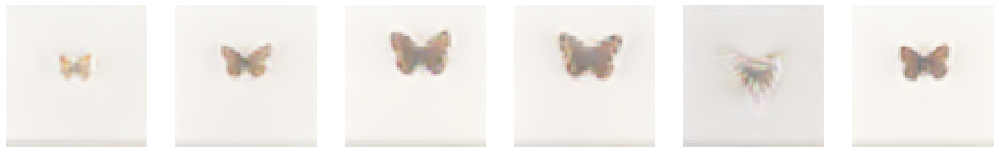

Step 2800: g_loss 0.0076 critic_loss -0.3440 critic fake -0.0230  critic_real -0.3210 penalty 0.0179


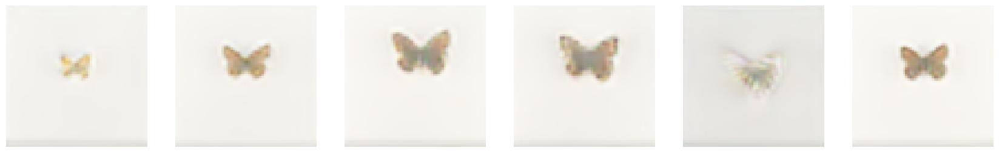

KeyboardInterrupt: 

In [15]:
wgan.train(image_batch, 512, 50000, 100)

1/1 [==============================] - 0s 14ms/step


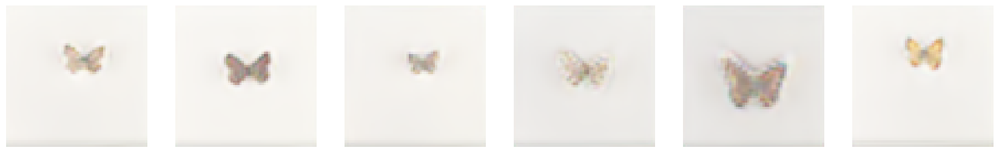

In [49]:
z = tf.random.normal((8, 128))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

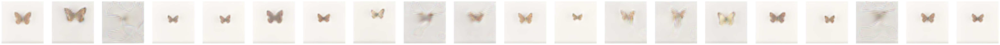

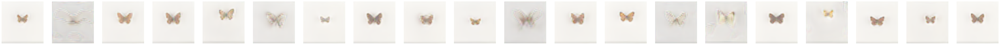

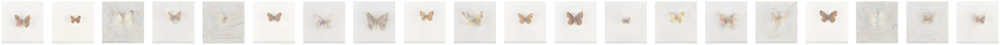

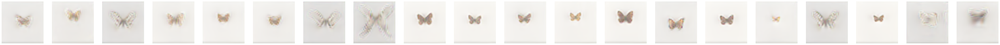

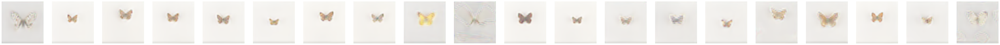

...

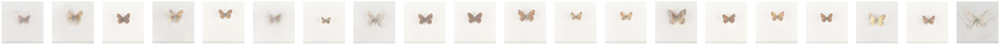

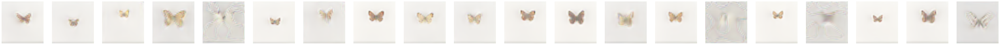

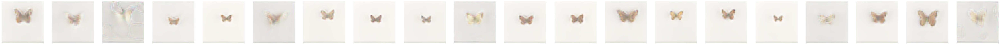

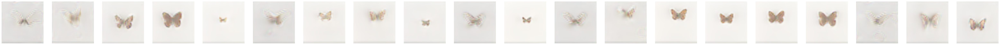

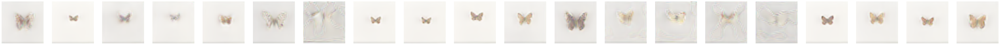

In [52]:
for i in range(20):
    z = tf.random.normal((20, 128))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

In [19]:
wgan.generator.save_weights('wgan_gp_butterfly_5000.weights')

In [20]:
wgan.generator.save('wgan_gp_butterfly_model_5000')

INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_5000\assets


INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_5000\assets


Step 0: g_loss 0.0091 critic_loss -0.3370 critic fake 0.0029  critic_real -0.3399 penalty 0.0093


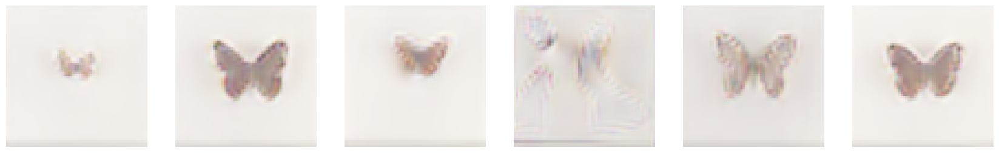

Step 100: g_loss 0.0108 critic_loss -0.3352 critic fake -0.0329  critic_real -0.3023 penalty 0.0082


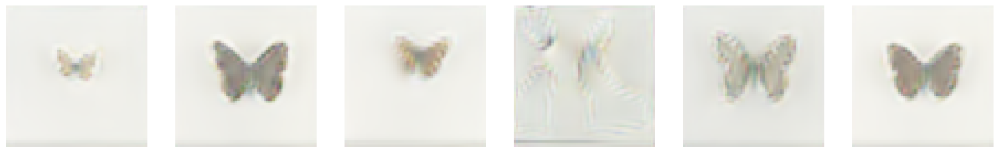

Step 200: g_loss 0.0205 critic_loss -0.3512 critic fake -0.0665  critic_real -0.2847 penalty 0.0560


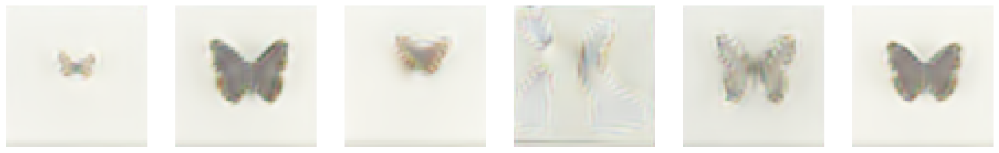

Step 300: g_loss -0.0202 critic_loss -0.3305 critic fake -0.0079  critic_real -0.3226 penalty 0.0000


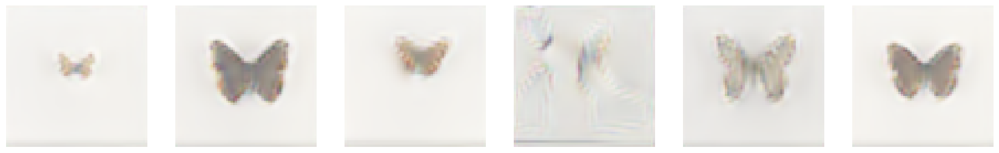

Step 400: g_loss 0.0154 critic_loss -0.3217 critic fake 0.0007  critic_real -0.3225 penalty 0.0131


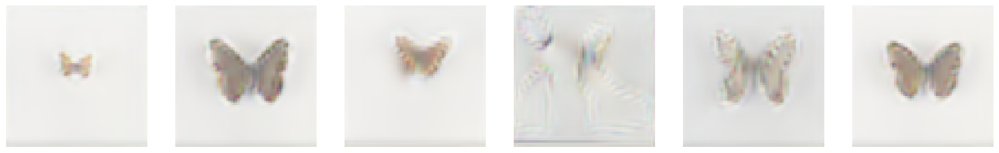

Step 500: g_loss -0.0064 critic_loss -0.3358 critic fake -0.0094  critic_real -0.3264 penalty 0.0224


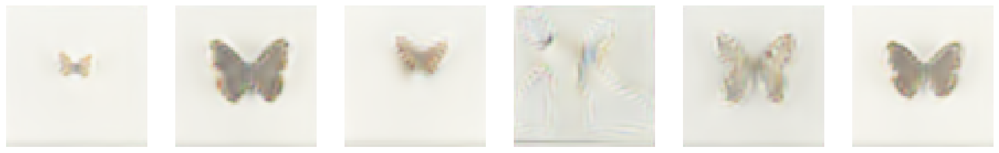

Step 600: g_loss 0.0029 critic_loss -0.3384 critic fake -0.0091  critic_real -0.3293 penalty 0.0230


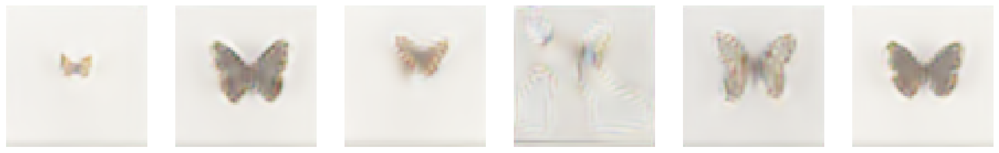

Step 700: g_loss -0.0050 critic_loss -0.3473 critic fake -0.0016  critic_real -0.3456 penalty 0.0017


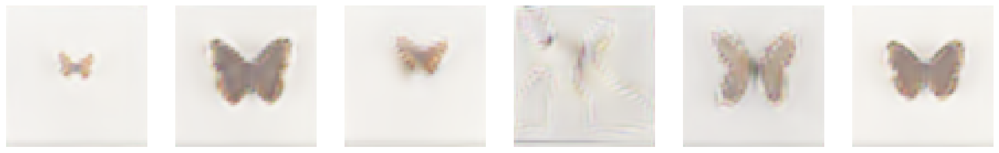

Step 800: g_loss 0.0260 critic_loss -0.3208 critic fake -0.0242  critic_real -0.2966 penalty 0.0210


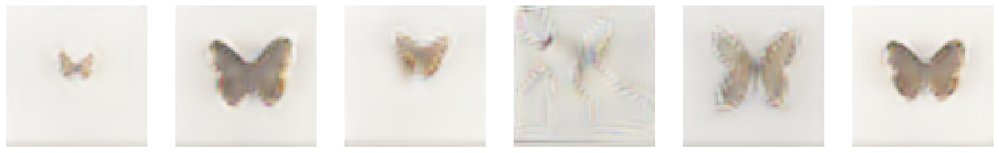

Step 900: g_loss 0.0199 critic_loss -0.3358 critic fake -0.0047  critic_real -0.3311 penalty 0.0007


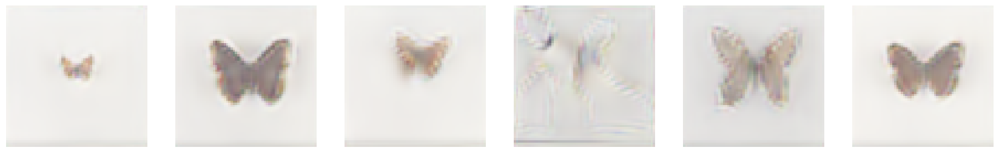

Step 1000: g_loss 0.0324 critic_loss -0.3367 critic fake -0.0384  critic_real -0.2983 penalty 0.0003


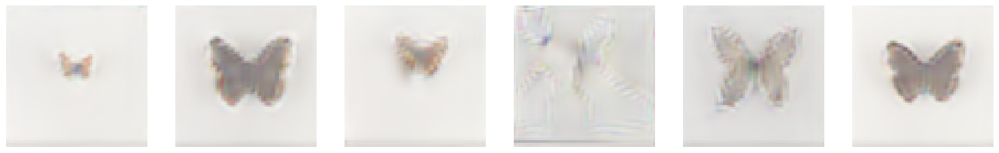

Step 1100: g_loss 0.0227 critic_loss -0.3446 critic fake 0.0037  critic_real -0.3483 penalty 0.0082


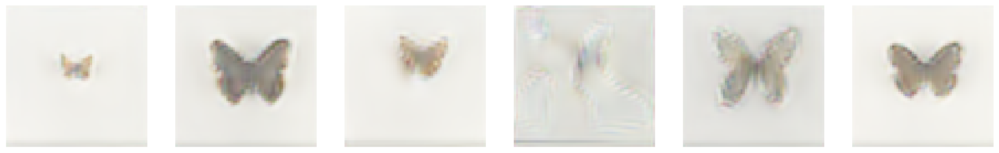

Step 1200: g_loss 0.0339 critic_loss -0.3427 critic fake 0.0244  critic_real -0.3671 penalty 0.0210


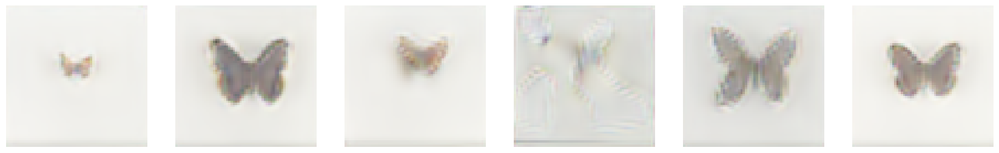

Step 1300: g_loss 0.0145 critic_loss -0.3371 critic fake -0.0130  critic_real -0.3241 penalty 0.0020


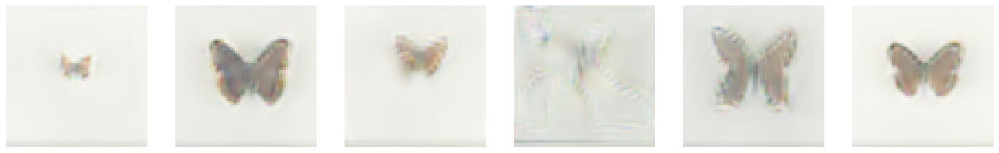

Step 1400: g_loss -0.0026 critic_loss -0.3301 critic fake 0.0191  critic_real -0.3493 penalty 0.0013


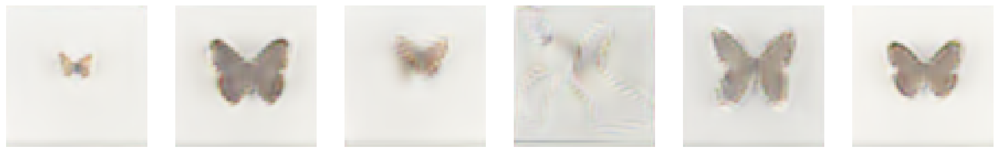

Step 1500: g_loss 0.0182 critic_loss -0.3447 critic fake -0.0093  critic_real -0.3354 penalty 0.0017


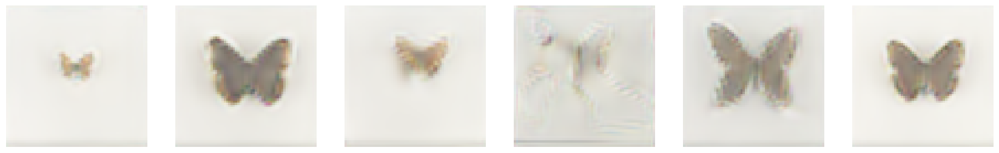

Step 1600: g_loss 0.0320 critic_loss -0.3442 critic fake -0.0017  critic_real -0.3425 penalty 0.0022


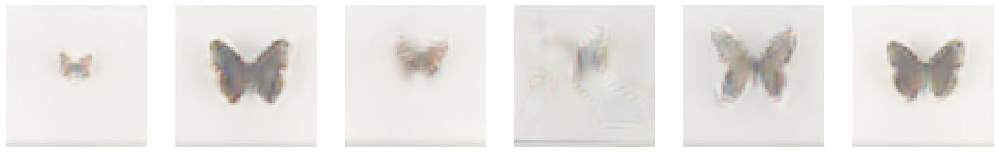

Step 1700: g_loss 0.0102 critic_loss -0.3396 critic fake -0.0298  critic_real -0.3099 penalty 0.0044


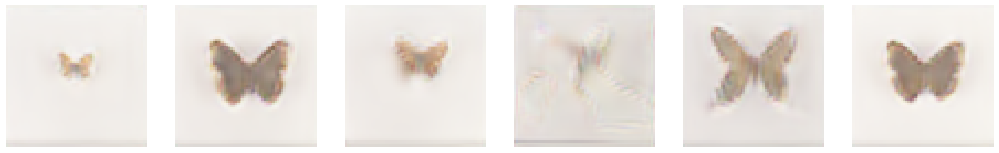

Step 1800: g_loss 0.0468 critic_loss -0.3567 critic fake -0.0539  critic_real -0.3028 penalty 0.0255


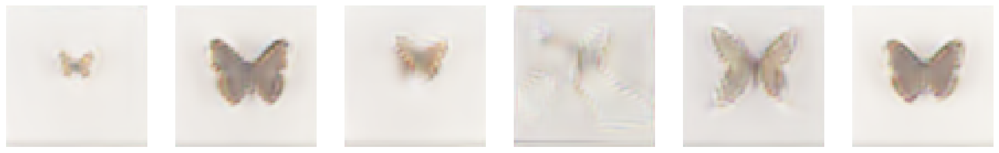

Step 1900: g_loss 0.0092 critic_loss -0.3431 critic fake 0.0058  critic_real -0.3489 penalty 0.0009


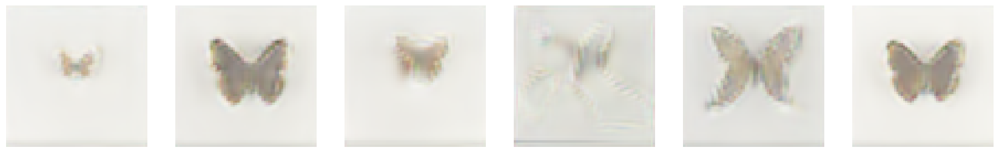

Step 2000: g_loss 0.0261 critic_loss -0.3338 critic fake -0.0336  critic_real -0.3003 penalty 0.0071


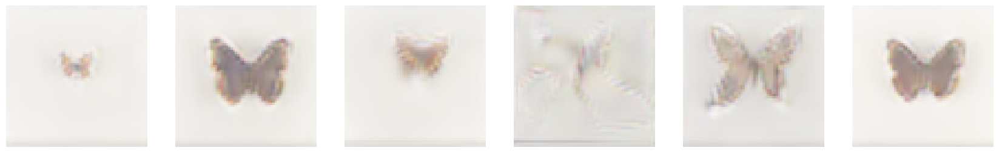

Step 2100: g_loss 0.0173 critic_loss -0.3401 critic fake -0.0166  critic_real -0.3235 penalty 0.0076


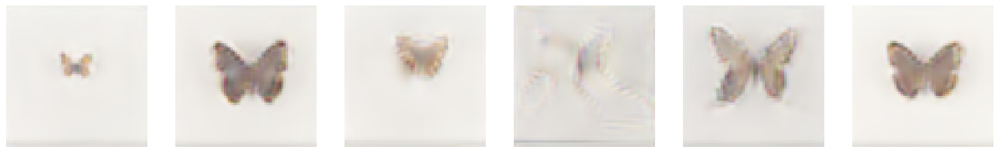

Step 2200: g_loss 0.0358 critic_loss -0.3517 critic fake -0.0218  critic_real -0.3299 penalty 0.0039


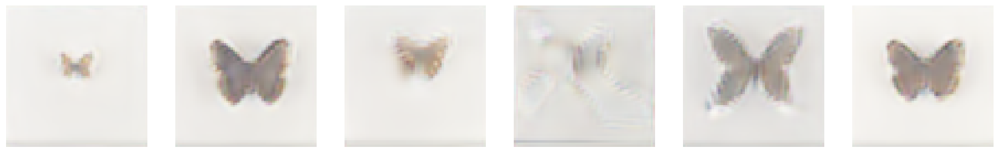

Step 2300: g_loss -0.0075 critic_loss -0.3512 critic fake -0.0071  critic_real -0.3441 penalty 0.0119


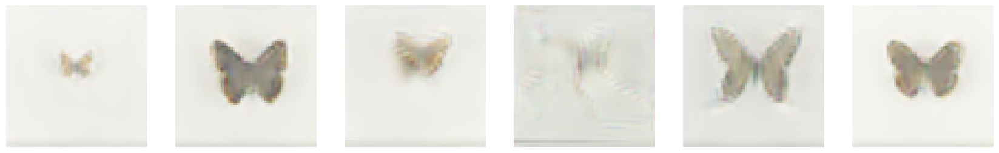

Step 2400: g_loss 0.0166 critic_loss -0.3527 critic fake -0.0173  critic_real -0.3354 penalty 0.0115


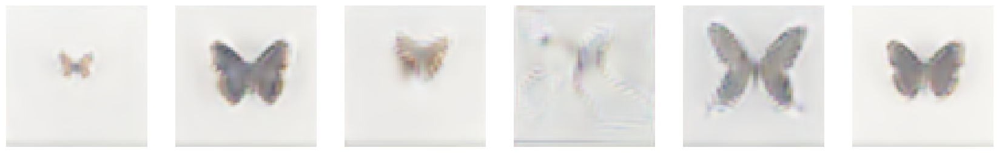

Step 2500: g_loss 0.0199 critic_loss -0.3475 critic fake -0.0353  critic_real -0.3122 penalty 0.0100


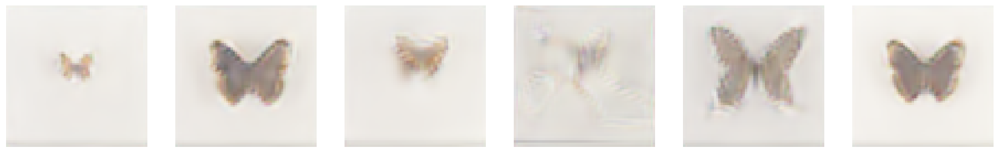

Step 2600: g_loss 0.0110 critic_loss -0.3477 critic fake -0.0175  critic_real -0.3302 penalty 0.0005


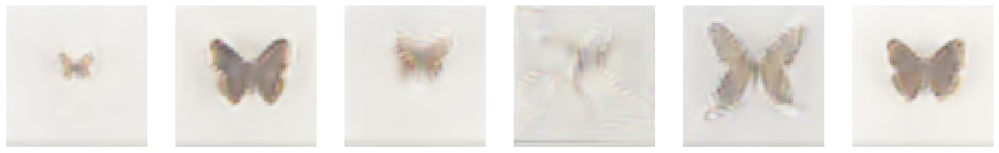

Step 2700: g_loss 0.0288 critic_loss -0.3347 critic fake -0.0188  critic_real -0.3158 penalty 0.0020


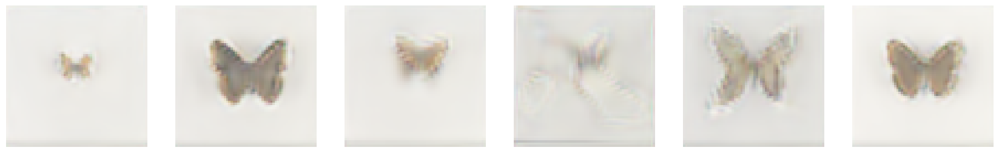

Step 2800: g_loss 0.0347 critic_loss -0.3496 critic fake -0.0370  critic_real -0.3126 penalty 0.0001


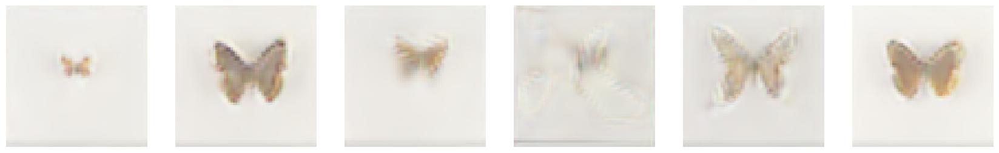

Step 2900: g_loss 0.0032 critic_loss -0.3571 critic fake -0.0003  critic_real -0.3568 penalty 0.0118


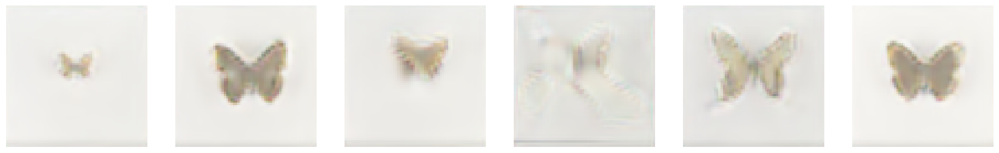

Step 3000: g_loss 0.0121 critic_loss -0.3533 critic fake -0.0050  critic_real -0.3484 penalty 0.0174


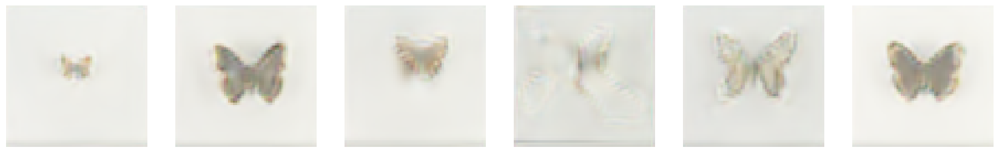

Step 3100: g_loss 0.0046 critic_loss -0.3391 critic fake -0.0269  critic_real -0.3122 penalty 0.0097


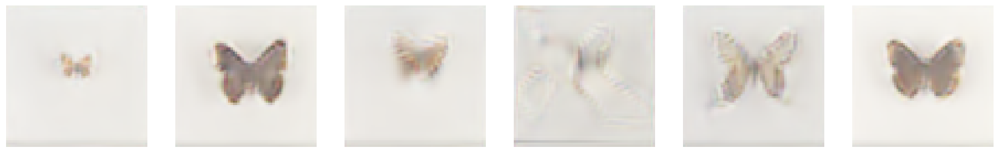

Step 3200: g_loss 0.0278 critic_loss -0.3444 critic fake -0.0160  critic_real -0.3284 penalty 0.0040


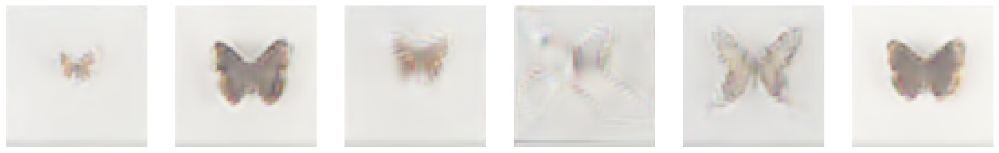

Step 3300: g_loss -0.0019 critic_loss -0.3632 critic fake -0.0037  critic_real -0.3594 penalty 0.0404


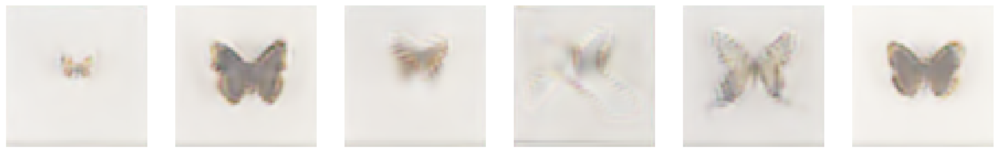

Step 3400: g_loss 0.0070 critic_loss -0.3505 critic fake -0.0293  critic_real -0.3212 penalty 0.0043


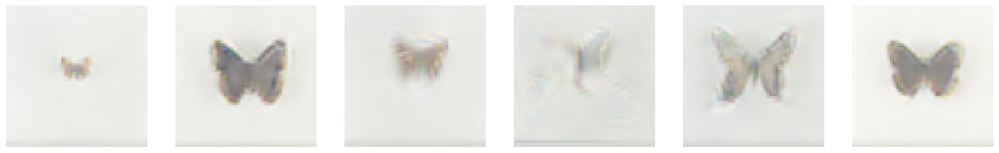

Step 3500: g_loss 0.0061 critic_loss -0.3522 critic fake -0.0137  critic_real -0.3385 penalty 0.0138


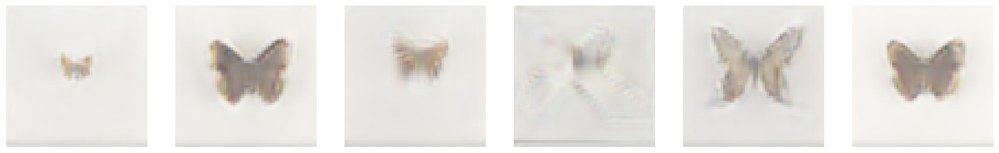

Step 3600: g_loss 0.0342 critic_loss -0.3485 critic fake -0.0070  critic_real -0.3415 penalty 0.0318


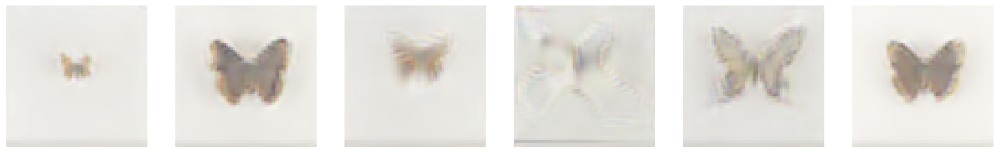

Step 3700: g_loss 0.0086 critic_loss -0.3442 critic fake -0.0133  critic_real -0.3309 penalty 0.0000


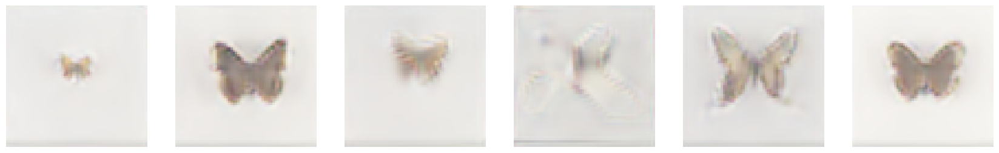

Step 3800: g_loss -0.0094 critic_loss -0.3541 critic fake -0.0068  critic_real -0.3473 penalty 0.0012


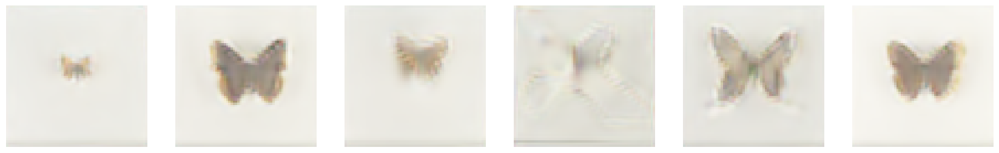

Step 3900: g_loss 0.0388 critic_loss -0.3639 critic fake -0.0326  critic_real -0.3313 penalty 0.0167


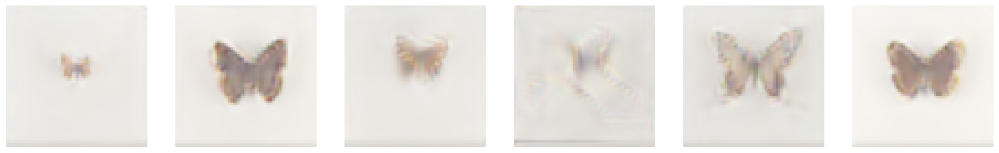

Step 4000: g_loss 0.0372 critic_loss -0.3426 critic fake -0.0209  critic_real -0.3217 penalty 0.0003


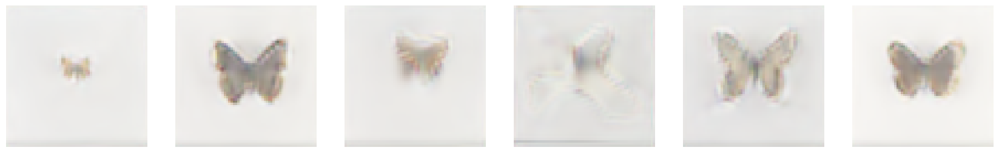

Step 4100: g_loss 0.0071 critic_loss -0.3436 critic fake -0.0082  critic_real -0.3353 penalty 0.0014


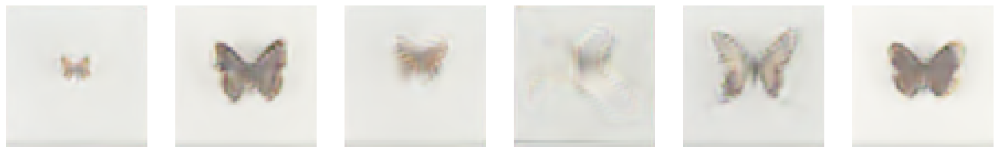

Step 4200: g_loss 0.0250 critic_loss -0.3374 critic fake -0.0310  critic_real -0.3064 penalty 0.0027


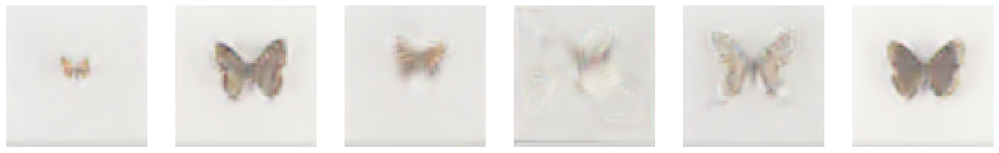

Step 4300: g_loss -0.0021 critic_loss -0.3496 critic fake -0.0132  critic_real -0.3363 penalty 0.0061


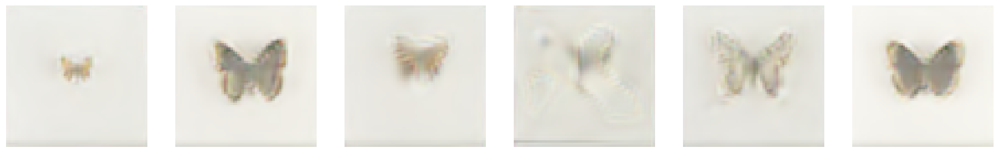

Step 4400: g_loss -0.0028 critic_loss -0.3471 critic fake -0.0096  critic_real -0.3374 penalty 0.0065


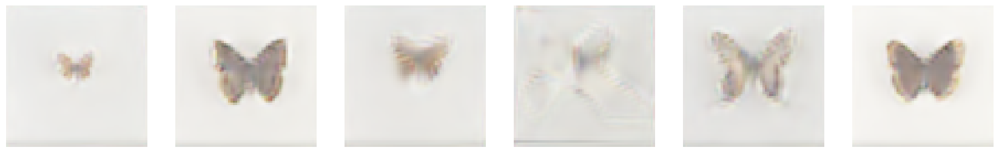

Step 4500: g_loss 0.0310 critic_loss -0.3531 critic fake -0.0180  critic_real -0.3351 penalty 0.0256


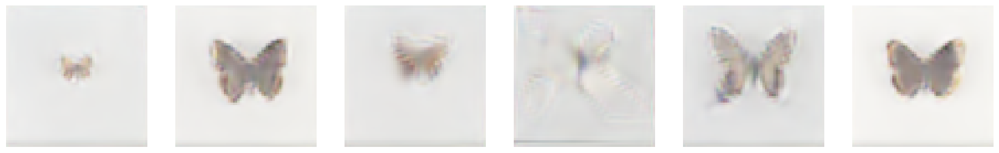

Step 4600: g_loss 0.0211 critic_loss -0.3442 critic fake -0.0068  critic_real -0.3373 penalty 0.0029


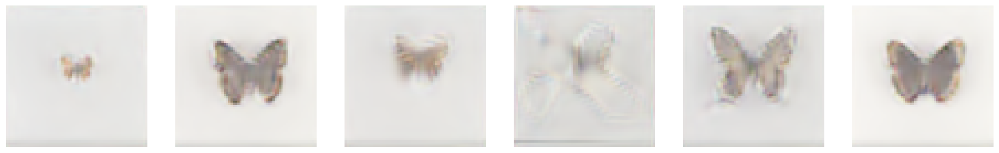

Step 4700: g_loss 0.0466 critic_loss -0.3501 critic fake -0.0291  critic_real -0.3210 penalty 0.0115


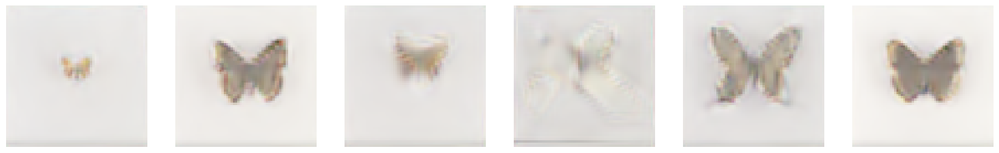

Step 4800: g_loss 0.0357 critic_loss -0.3449 critic fake -0.0178  critic_real -0.3271 penalty 0.0002


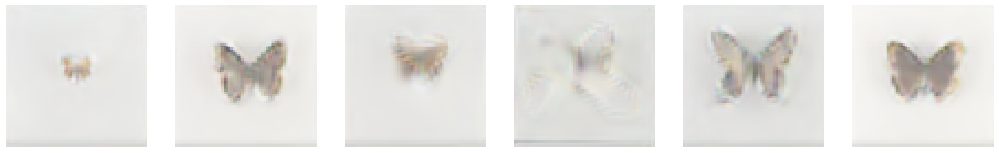

Step 4900: g_loss 0.0205 critic_loss -0.3491 critic fake -0.0060  critic_real -0.3431 penalty 0.0004


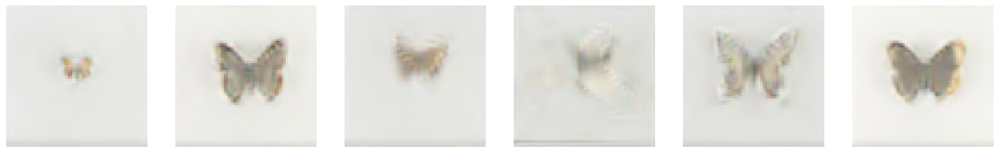

Step 5000: g_loss 0.0083 critic_loss -0.3376 critic fake -0.0130  critic_real -0.3246 penalty 0.0018


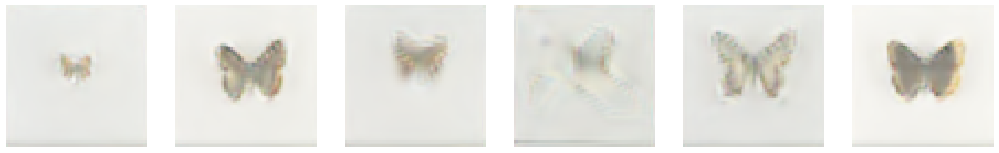

Step 5100: g_loss 0.0034 critic_loss -0.3392 critic fake -0.0057  critic_real -0.3335 penalty 0.0037


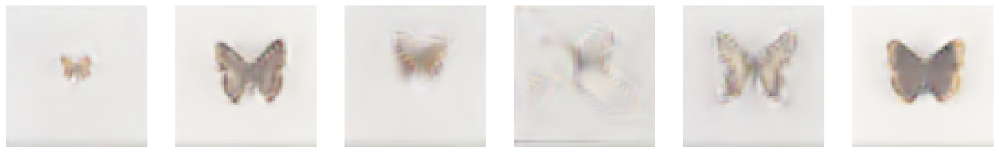

Step 5200: g_loss -0.0026 critic_loss -0.3461 critic fake 0.0039  critic_real -0.3500 penalty 0.0045


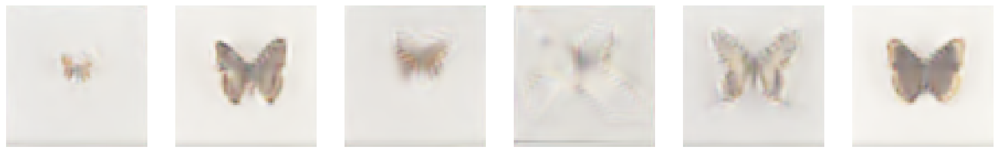

Step 5300: g_loss -0.0004 critic_loss -0.3377 critic fake -0.0107  critic_real -0.3270 penalty 0.0008


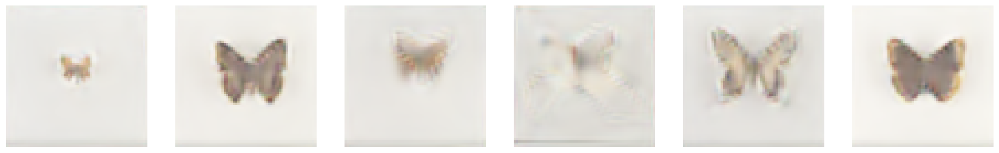

Step 5400: g_loss -0.0026 critic_loss -0.3577 critic fake -0.0130  critic_real -0.3446 penalty 0.0419


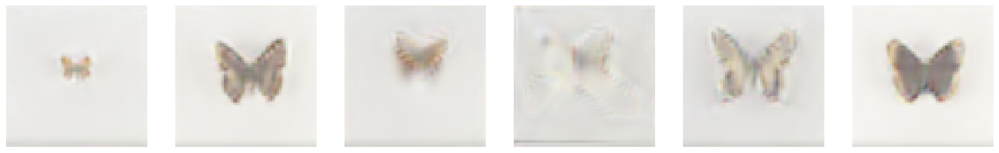

Step 5500: g_loss 0.0355 critic_loss -0.3526 critic fake -0.0580  critic_real -0.2946 penalty 0.0166


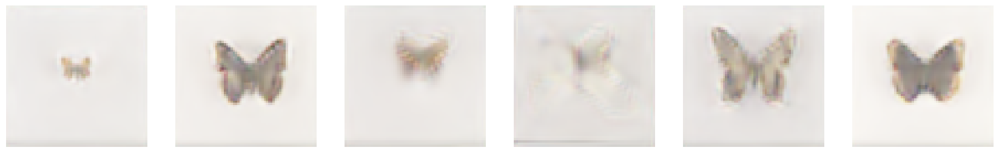

Step 5600: g_loss 0.0228 critic_loss -0.3376 critic fake -0.0107  critic_real -0.3269 penalty 0.0038


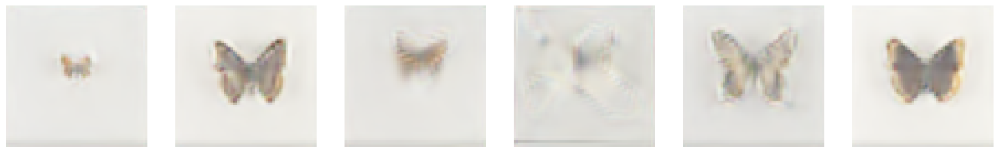

Step 5700: g_loss 0.0128 critic_loss -0.3457 critic fake -0.0047  critic_real -0.3410 penalty 0.0042


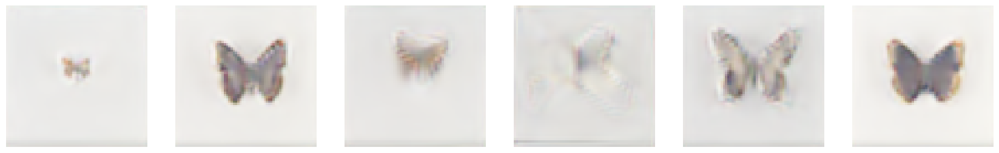

Step 5800: g_loss 0.0150 critic_loss -0.3396 critic fake -0.0145  critic_real -0.3251 penalty 0.0042


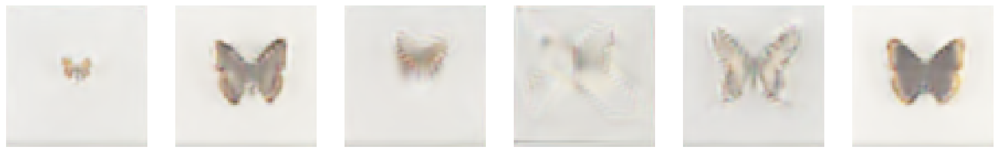

Step 5900: g_loss 0.0111 critic_loss -0.3424 critic fake -0.0195  critic_real -0.3229 penalty 0.0012


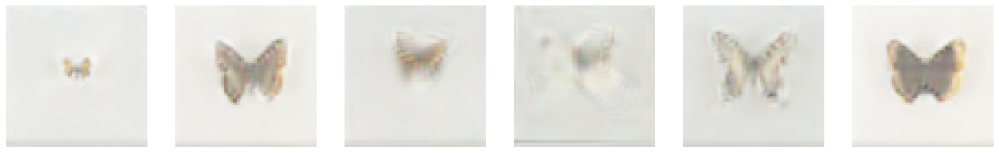

Step 6000: g_loss 0.0072 critic_loss -0.3432 critic fake 0.0021  critic_real -0.3453 penalty 0.0002


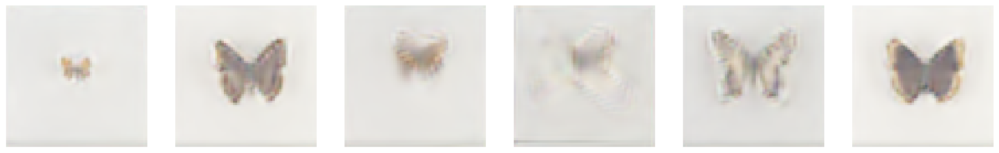

Step 6100: g_loss -0.0062 critic_loss -0.3347 critic fake -0.0065  critic_real -0.3282 penalty 0.0025


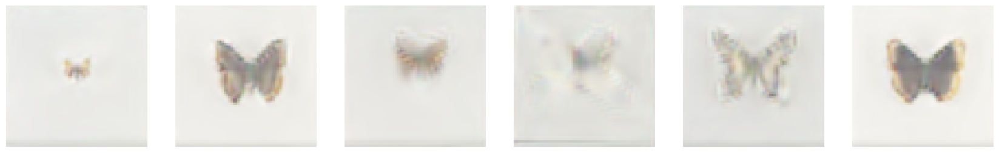

Step 6200: g_loss 0.0145 critic_loss -0.3347 critic fake -0.0267  critic_real -0.3080 penalty 0.0000


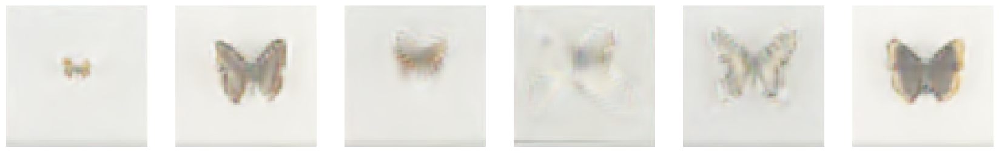

Step 6300: g_loss 0.0117 critic_loss -0.3502 critic fake -0.0012  critic_real -0.3490 penalty 0.0032


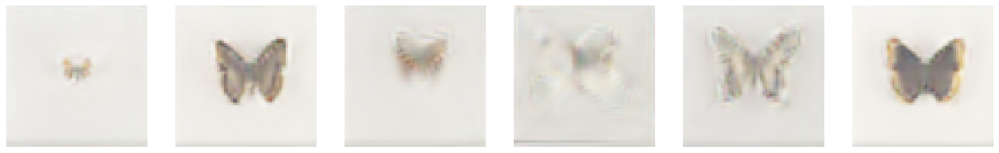

Step 6400: g_loss -0.0138 critic_loss -0.3483 critic fake -0.0076  critic_real -0.3407 penalty 0.0110


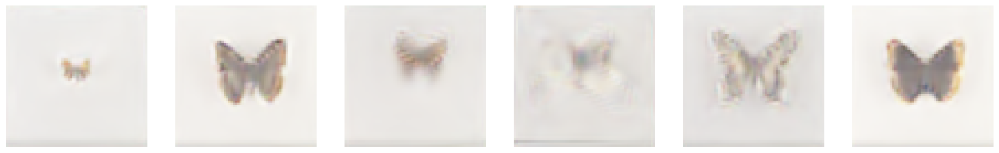

Step 6500: g_loss 0.0083 critic_loss -0.3460 critic fake -0.0125  critic_real -0.3335 penalty 0.0073


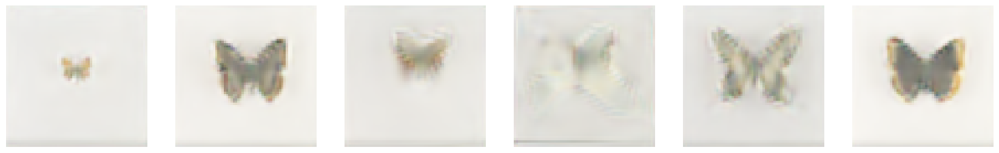

Step 6600: g_loss 0.0094 critic_loss -0.3426 critic fake -0.0209  critic_real -0.3217 penalty 0.0000


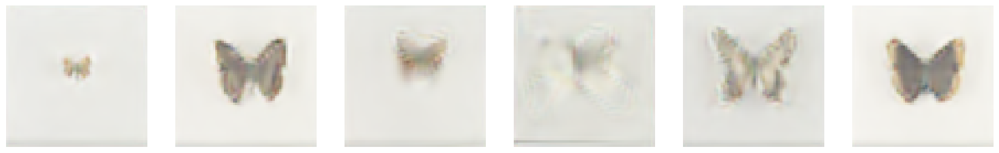

KeyboardInterrupt: 

In [55]:
wgan.train(image_batch, 512, 50000, 100)

In [56]:
wgan.generator.save_weights('wgan_gp_butterfly_11600.weights')

In [57]:
wgan.generator.save('wgan_gp_butterfly_model_11600')

INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_11600\assets


INFO:tensorflow:Assets written to: wgan_gp_butterfly_model_11600\assets


1/1 [==============================] - 0s 20ms/step


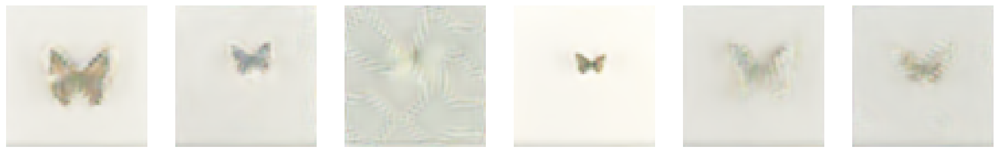

In [64]:
z = tf.random.normal((8, 128))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

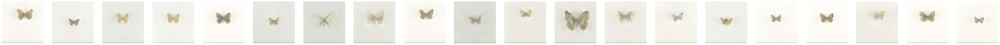

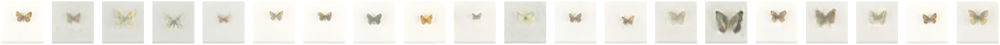

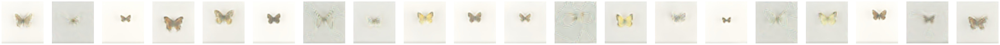

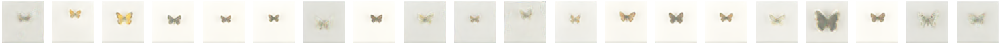

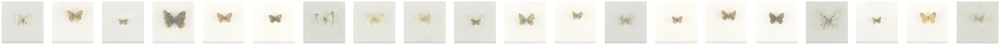

...

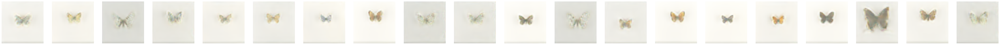

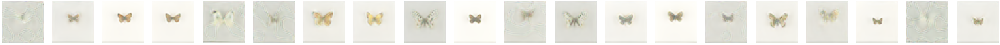

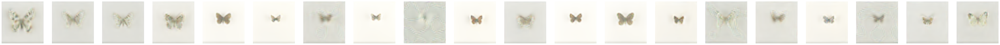

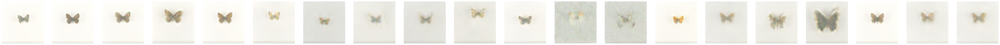

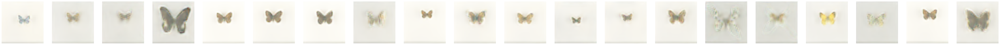

In [59]:
for i in range(20):
    z = tf.random.normal((20, 128))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

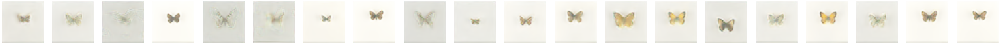

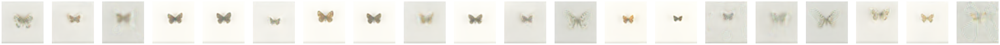

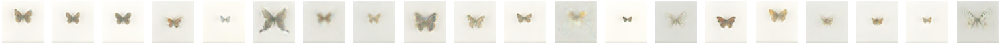

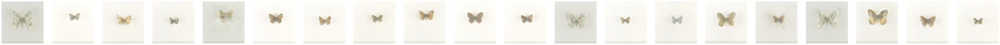

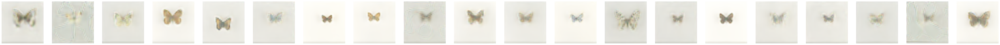

...

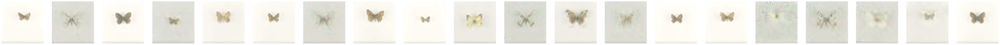

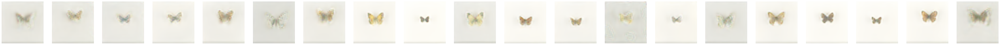

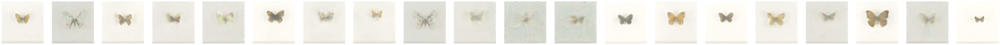

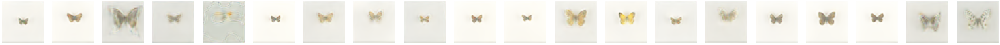

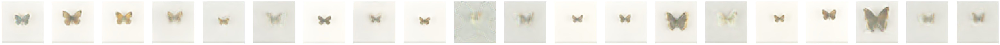

In [60]:
for i in range(20):
    z = tf.random.normal((20, 128))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

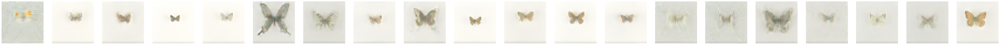

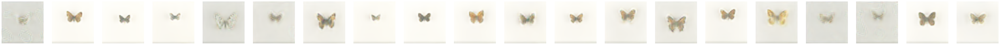

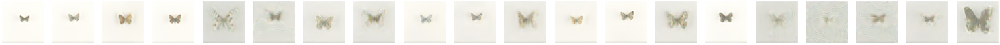

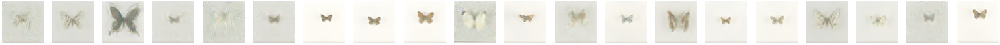

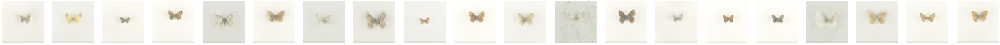

...

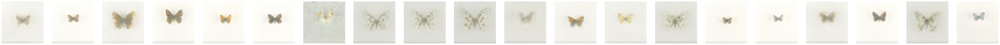

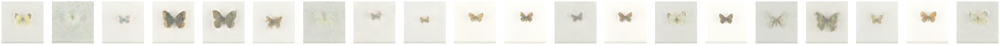

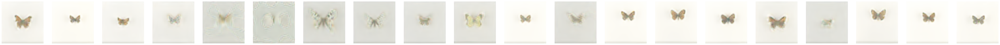

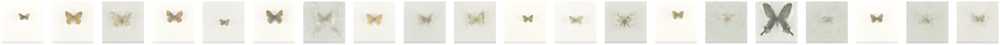

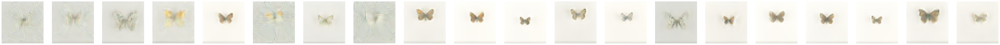

In [65]:
for i in range(20):
    z = tf.random.normal((20, 128))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()